## Visualizing the embeddings

In this notebook I use tSNE and PCA to visualize the embeddings and then create wordclouds of the clusters

I first ran the silhouette analysis, and it doesn't look like there are any clear clusters. 

At larger cluster numbers, i can sometimes see a differnce in the clusters. like old vs new, men vs women poets etc. But I dont think they are very stable. 

And i do not know enough about the subject to really eyeball the differences. A legit poetry-nerd might find them very illuminating. 

In [2]:
import pandas as pd
import pickle

In [3]:
embedding_cache_path = 'data/all-poems-AC-AN-jina-v2-base-en-embeddings.pkl'
with open(embedding_cache_path, "rb") as fIn:
    cache_data = pickle.load(fIn)
    corpus_embeddings = cache_data['embedding']


In [4]:
corpus_cache_path = 'data/poem-corpus.pkl'
with open(corpus_cache_path, "rb") as f:
    poems = pickle.load(f) 

In [25]:
cache_data.keys()

dict_keys(['poem_id', 'poem', 'embedding'])

In [36]:
len(corpus_embeddings)

16807

In [6]:
df =  pd.read_csv("AP-stopword-cleaned-for-wordclouds.csv")

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16808 entries, 0 to poem_for_display
Data columns (total 1 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   poem_for_display  16807 non-null  object
dtypes: object(1)
memory usage: 262.6+ KB


## Dimensionality Reduction 

In [7]:
from sklearn.manifold import TSNE

# Great for preserving local features of clusters

tsne_model = TSNE(
    n_components=2,
    perplexity=50,
    n_iter=5000,
    n_iter_without_progress=500,
    metric="cosine",
)
tsne_embeddings = tsne_model.fit_transform(corpus_embeddings)

In [9]:
from sklearn.cluster import KMeans
import numpy as np

NUM_CLUSTERS = 3 #decided based on silhouette analysis

tsne_kmeans = KMeans(n_clusters=NUM_CLUSTERS, max_iter=1000, n_init=1000, random_state=42)

tsne_cluster_labels = tsne_kmeans.fit_predict(tsne_embeddings)

unique_labels, category_sizes = np.unique(tsne_cluster_labels, return_counts=True)

cluster_ids, cluster_sizes = np.unique(tsne_kmeans.labels_, return_counts=True)


print(f"Number of elements assigned to each cluster: {cluster_sizes}")

Number of elements assigned to each cluster: [5425 6204 5178]


In [8]:
from sklearn.decomposition import PCA

#Great for preserving generalized features of the dataset


pca = PCA(n_components=2)  # You can choose the number of components
pca_embeddings = pca.fit_transform(corpus_embeddings)


In [10]:
len(pca_embeddings)

16807

In [10]:

NUM_CLUSTERS = 3

pca_kmeans = KMeans(n_clusters=NUM_CLUSTERS, max_iter=1000, n_init=1000, random_state=42)

pca_cluster_labels = pca_kmeans.fit_predict(pca_embeddings)

unique_labels, category_sizes = np.unique(pca_cluster_labels, return_counts=True)

cluster_ids, cluster_sizes = np.unique(pca_kmeans.labels_, return_counts=True)


print(f"Number of elements assigned to each cluster: {cluster_sizes}")
# print(
#     "True number of documents in each category according to the class labels: "
#     f"{category_sizes}"
# )
 

Number of elements assigned to each cluster: [4138 6624 6045]


In [11]:
df.dropna(inplace=True)

## Visualize the clusters

In [77]:
import plotly.express as px

# Create a DataFrame with corpus texts, cluster labels, and corpus IDs
pca_data = {
    'CorpusID': df.index[:16807],  # Replace with your corpus IDs
    'Cluster': pca_cluster_labels[:16807],  # Cluster labels from K-Means
    'Text': df["poem_for_display"][:16807]  # Replace with your corpus texts
}
pca_df = pd.DataFrame(pca_data)
pca_df['pca_1'] = pca_embeddings[:, 0][:16807]
pca_df['pca_2'] = pca_embeddings[:, 1][:16807]

# Create an interactive scatter plot with Plotly

In [ ]:
fig = px.colors.sequential.swatches()
fig.show()

In [78]:
fig = px.scatter(pca_df, x='pca_1', y='pca_2', color='Cluster', hover_data=['CorpusID'], color_continuous_scale=px.colors.sequential.Agsunset)
fig.update_layout(
    title="PCA Corpus Embeddings Clustering",
    xaxis_title="Dimension 1",
    yaxis_title="Dimension 2"
)
fig.show()

In [79]:
import plotly.express as px

# Create a DataFrame with corpus texts, cluster labels, and corpus IDs
tsne_data = {
    'CorpusID': df.index[:16807],  # Replace with your corpus IDs
    'Cluster': tsne_cluster_labels[:16807],  # Cluster labels from K-Means
    'Text': df["poem_for_display"][:16807]  # 

}
tsne_df = pd.DataFrame(tsne_data)
tsne_df['tsne_1'] = tsne_embeddings[:, 0][:16807]
tsne_df['tsne_2'] = tsne_embeddings[:, 1][:16807]

# Create an interactive scatter plot with Plotly

In [80]:
fig = px.scatter(tsne_df, x='tsne_1', y='tsne_2', color='Cluster', hover_data=['CorpusID'], color_continuous_scale=px.colors.sequential.Agsunset)
fig.update_layout(
    title="t-SNE Corpus Embeddings Clustering",
    xaxis_title="Dimension 1",
    yaxis_title="Dimension 2"
)
fig.show()

In [81]:
tsne_df[tsne_df["Cluster"]==0][:10]

,CorpusID,Cluster,Text,tsne_1,tsne_2
2,2,0,giant yea theodore weiss giant yea bear idea e...,-0.960429,15.440004
3,3,0,seder night israel zangwill seder night prosai...,-10.217779,27.068310
10,10,0,euclid alone looked beauty bare edna st vincen...,-24.239599,15.498608
11,11,0,arms boy wilfred owen arms boy let boy try alo...,-35.838230,20.468170
14,14,0,mr henry lawes katherine philips mr henry lawe...,-3.643385,18.284964
15,15,0,great great great great grandfather owned grea...,-30.644156,22.936956
17,17,0,exegesis first words spoken ishmael dan beachy...,4.784853,33.199516
18,18,0,jv wrestling joshua rivkin jv wrestling struck...,0.154062,37.614975
19,19,0,parting john frederick nims parting knowing se...,11.676045,25.029303
22,22,0,light shining darkness william cowper light sh...,-8.209344,37.536758


In [108]:
print("Cluster: ", tsne_df[tsne_df.CorpusID==87]["Cluster"].item())
print(poems[87])

Cluster:  1
My Lover Who Lives Far
by: Camille T. Dungy
url : https://www.poetryfoundation.org/poems/58390/my-lover-who-lives-far

My lover, who lives far away, opens the door to my room
          and offers supper in a bowl made of his breath. 
 The stew has boiled and I wonder at the cat born from its steam. 
 The cat is in the bedroom now, mewling. The cat is indecent
           and I, who am trying to be tidy, I, who am trying to do things
           the proper way, I, who am sick from the shedding, I am undone. 
 My lover, who lives far away, opens the door to my room
           and offers pastries in a basket spun from his vision. 
 It is closely woven, the kind of container some women collect. 
 I have seen these in many colors, but the basket he brings is simple:
       only black, only nude. The basket he brings is full of sweet scones
        and I eat even the crumbs. As if I've not dined for days. 
 My lover, who lives far away, opens the door to my room
         and offers

In [109]:
print("Cluster: ", tsne_df[tsne_df.CorpusID==923]["Cluster"].item())
print(poems[923])

Cluster:  2
Cloud Hands
by: Arthur Sze
url : https://www.poetryfoundation.org/poems/160604/cloud-hands

A woman moves through a Cloud Hands position,
                         holding and rotating 
 an invisible globe—thud, shattering glass, moan,
                         horn blast—so many 
 worlds to this world—two men dipnet
                         sockeye salmon 
 at the mouth of a river—from a rooftop, a seagull
                         squawks and cries; 
 a woman moves through Grasp the Bird’s Tail—
                         someone on a stretcher 
 is wheeled past glass doors—a desert fivespot
                         rises in a wash— 
 and, pressing her tongue to the roof
                         of her mouth, 
 she focuses, in the near distance, on the music
                         of sycamore leaves.

++++++++




### t-SNE wordclouds

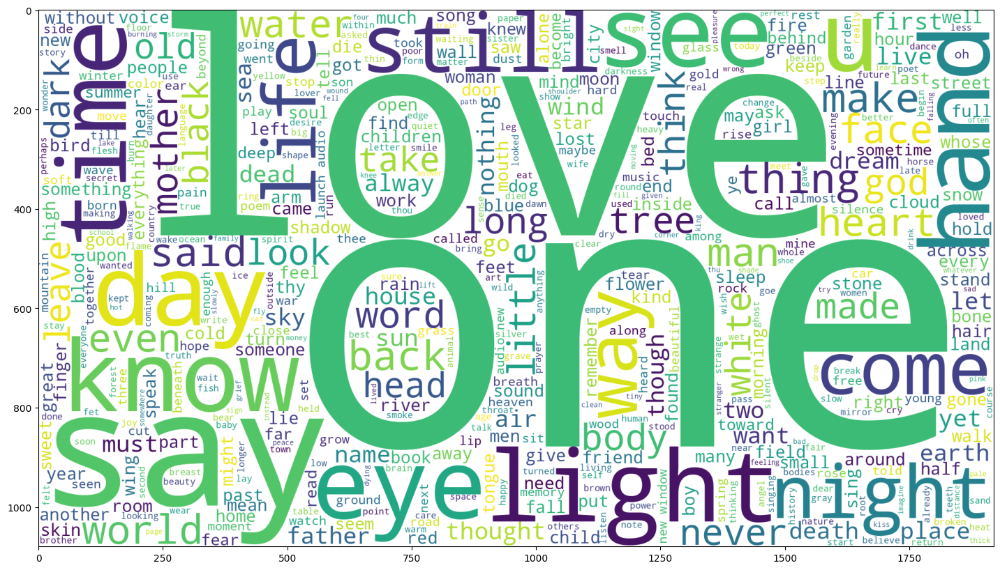

In [82]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500).generate(' '.join(tsne_df.Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

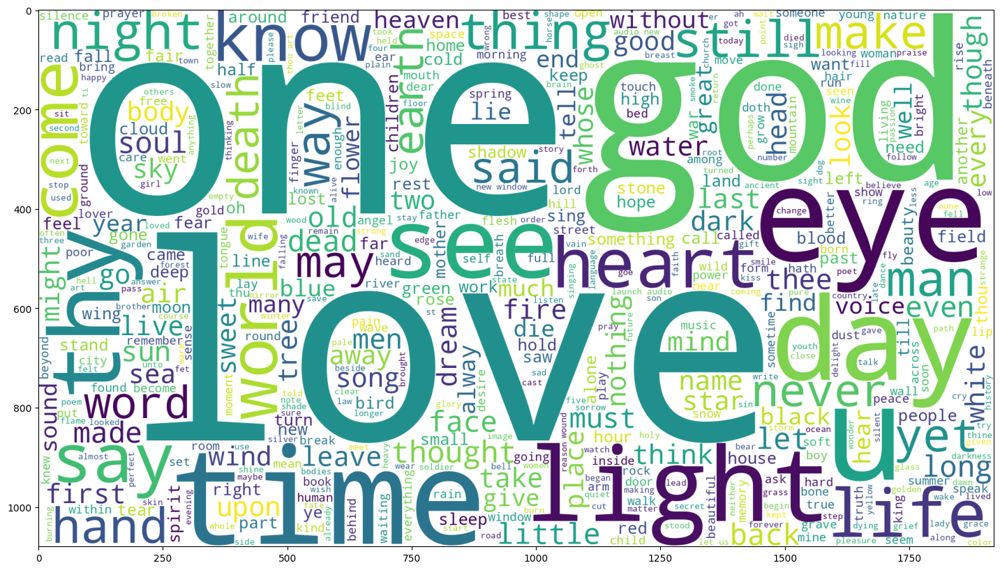

In [88]:
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500).generate(' '.join(tsne_df[tsne_df.Cluster==0].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

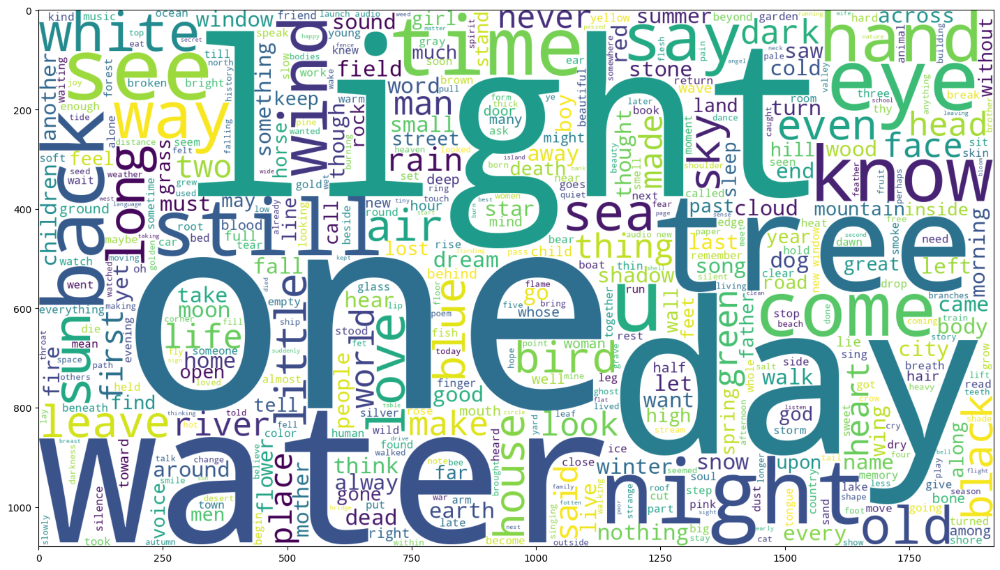

In [90]:
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500).generate(' '.join(tsne_df[tsne_df.Cluster==2].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

In [91]:
tsne_df[tsne_df.Text.str.contains("one")]

,CorpusID,Cluster,Text,tsne_1,tsne_2
0,0,2,fianuis kathleen jamie fianuis well friend sau...,-29.792913,-14.363275
1,1,2,grieve walter clyde curry grieve grieve winter...,-22.298307,-6.382777
2,2,0,giant yea theodore weiss giant yea bear idea e...,-0.960429,15.440004
4,4,2,poem occasion weekly staff meeting matthew zap...,-12.697699,0.624050
5,5,1,topeka topeka nick twemlow topeka topeka topek...,12.603208,-20.676315
...,...,...,...,...,...
16800,16800,0,poet wrestling true nature photon rosebud ben ...,7.679217,10.749457
16802,16802,1,launch audio new window khadijah queen gold fi...,5.716724,1.665660
16804,16804,1,launch audio new window nick flynn cathedral s...,19.601355,21.230196
16805,16805,1,grew places gone jennifer robertson grew place...,42.499996,-23.292501


In [92]:
print(tsne_df.iloc[16800]["Text"])

poet wrestling true nature photon rosebud ben oni poet wrestling true nature photon want know answer everything mean land moon styx smallest pluto stick wreath water ice leave without even taking photo tell got wrong giving attention ache ardor electron busy binding matter clearly stable holding heads keeping hearts dark electron looks reality keeps going somewhere peacock mystique pitching salt cross black cat ladder another little belief youronly bond whispering macbeth dark theatre rattling every full house hours every hand dropping glass turning toss breath sleep less spinning parasol indoors one sock shoes table unbinding human condition eyes straining see less mirror breaks every billion years think carefully you never room refuge intruding matter wins quite end thing disturbance exist discovered yet appears ceases everything promise never since photon receptive self evident yet answer yourtrillions moons orbit swift disturbances look look even get smallest bit close u creep cant

###  PCA wordclouds

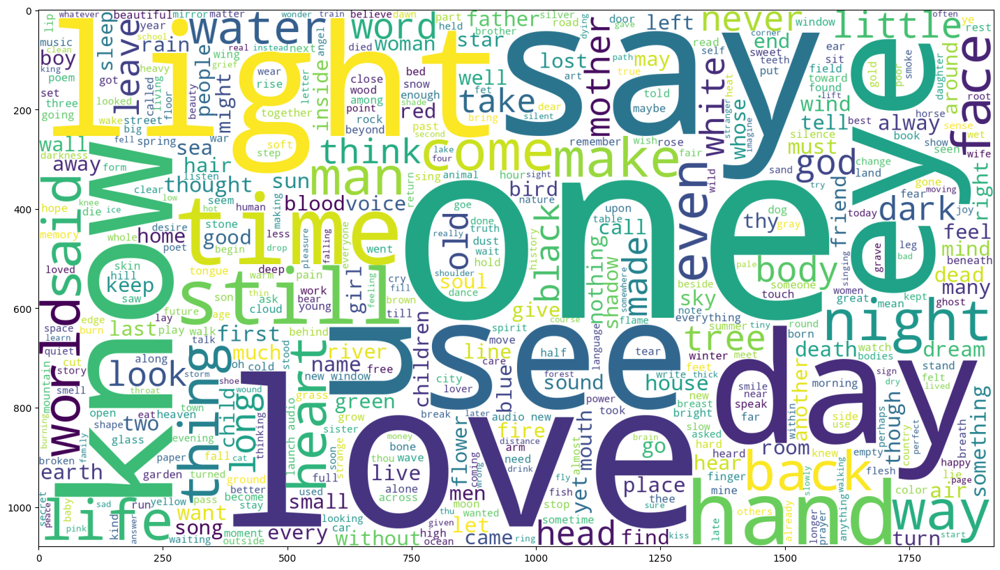

In [94]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500).generate(' '.join(pca_df.Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

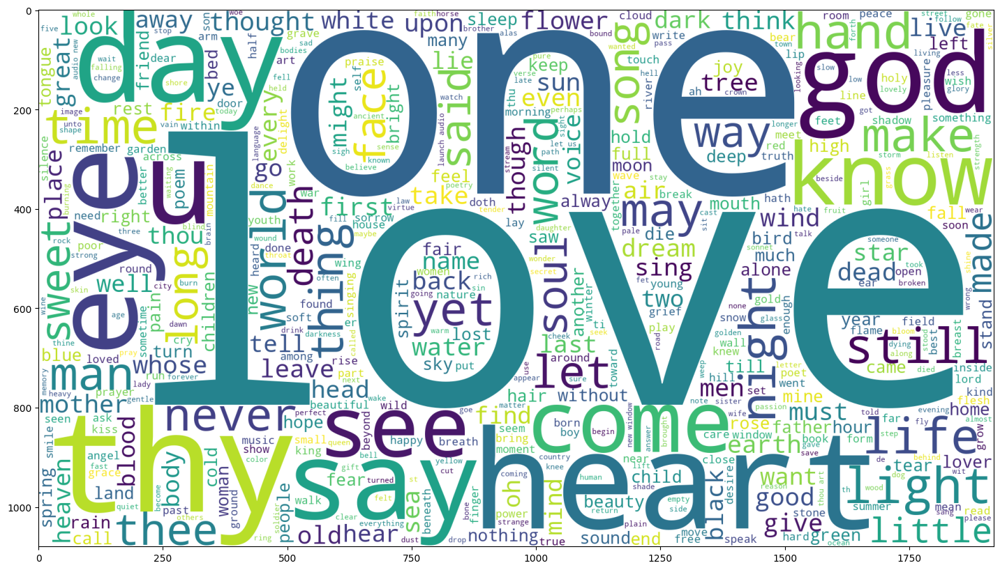

In [95]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500).generate(' '.join(pca_df[pca_df.Cluster==0].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

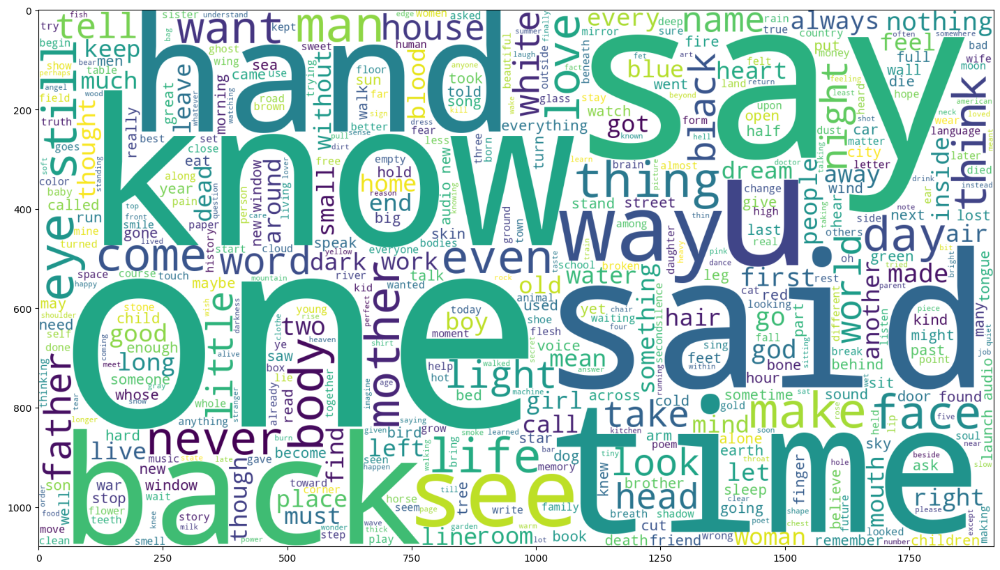

In [96]:
from  wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color="white",width=1920, height=1080, max_words =500).generate(' '.join(pca_df[pca_df.Cluster==1].Text.tolist()))
plt.figure(figsize=(20,10))
plt.imshow(wordcloud)

## Silhouette analysis

For n_clusters = 2 The average silhouette_score is : 0.33546838
For n_clusters = 3 The average silhouette_score is : 0.37638065
For n_clusters = 4 The average silhouette_score is : 0.34218082
For n_clusters = 5 The average silhouette_score is : 0.33009917
For n_clusters = 6 The average silhouette_score is : 0.3526353
For n_clusters = 7 The average silhouette_score is : 0.34098753


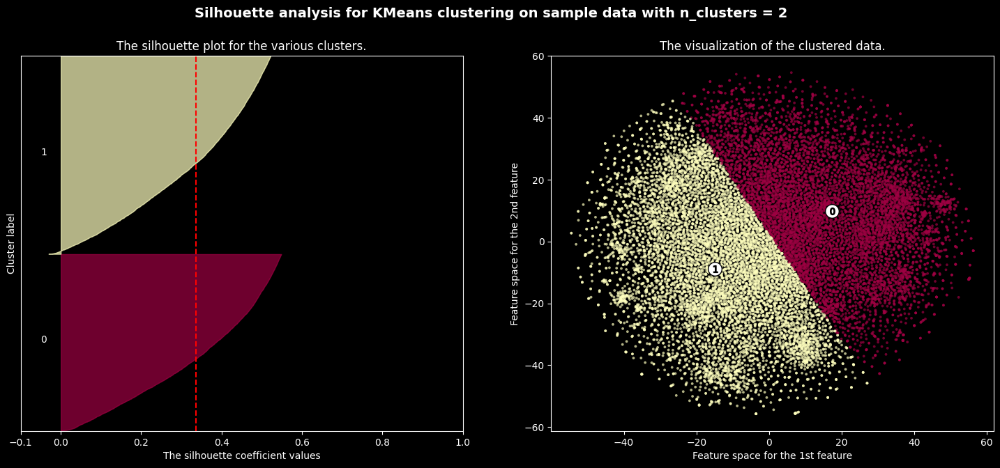

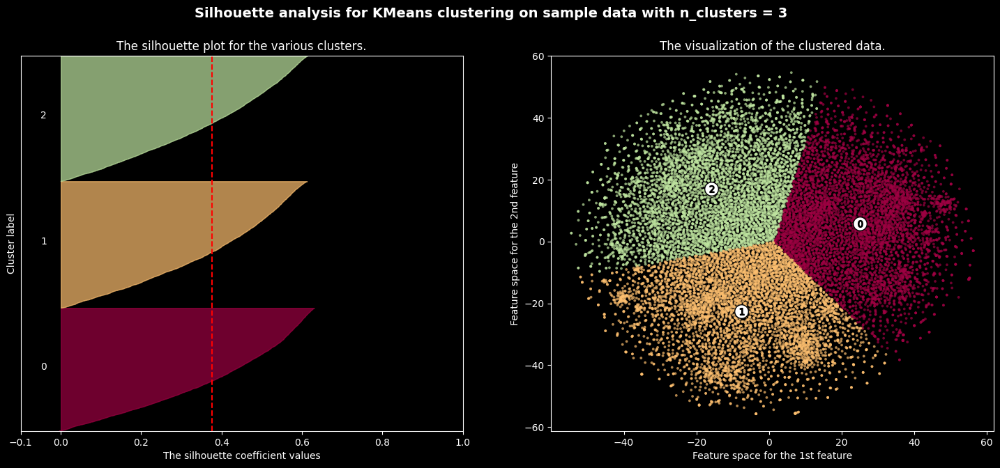

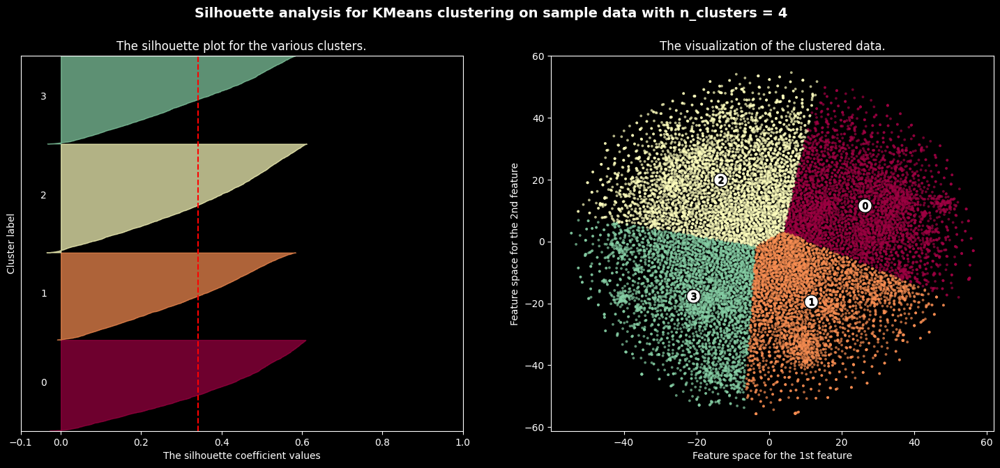

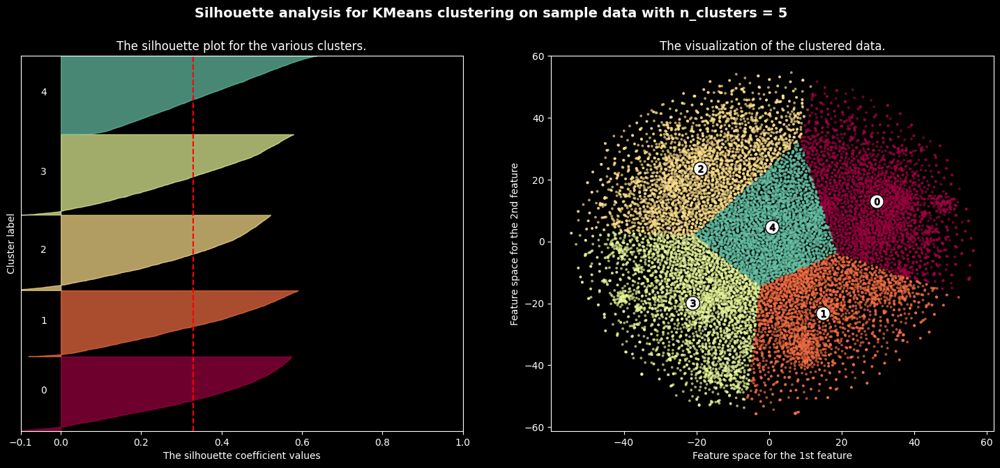

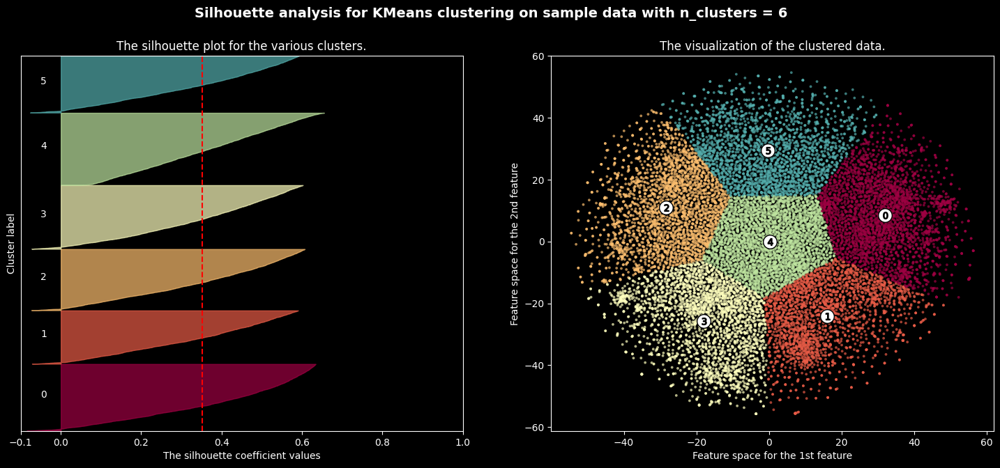

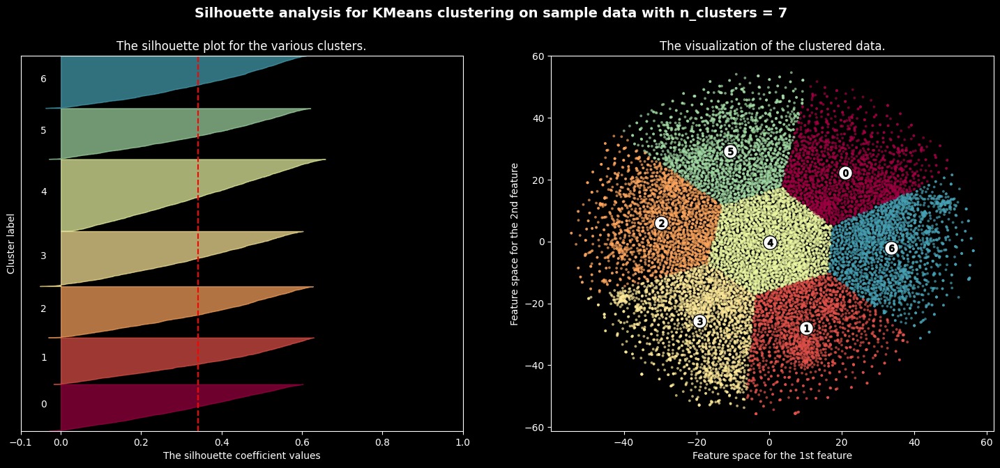

In [26]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [2,3,4,5,6,7]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(tsne_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator

    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=42)
    cluster_labels = clusterer.fit_predict(tsne_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(tsne_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(tsne_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        tsne_embeddings[:, 0], tsne_embeddings[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

For n_clusters = 6 The average silhouette_score is : 0.3526353
For n_clusters = 10 The average silhouette_score is : 0.32692602
For n_clusters = 15 The average silhouette_score is : 0.3353913
For n_clusters = 20 The average silhouette_score is : 0.32873306
For n_clusters = 50 The average silhouette_score is : 0.3275198


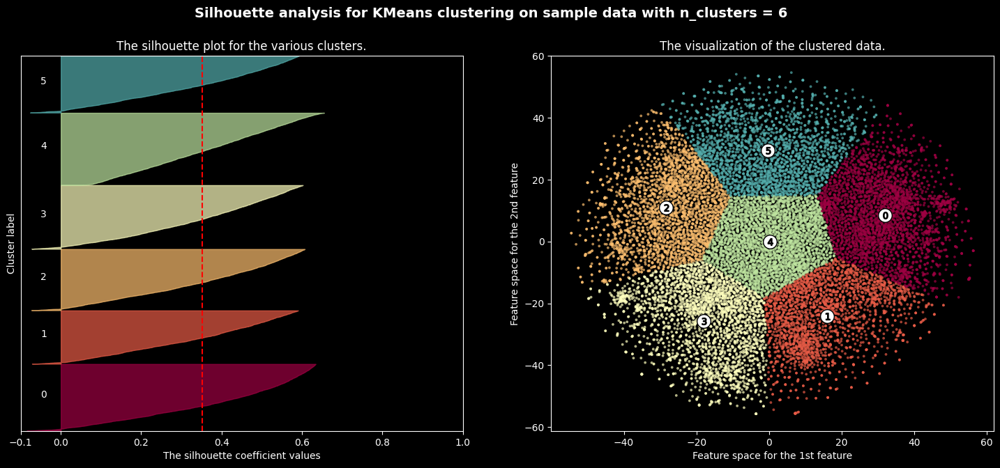

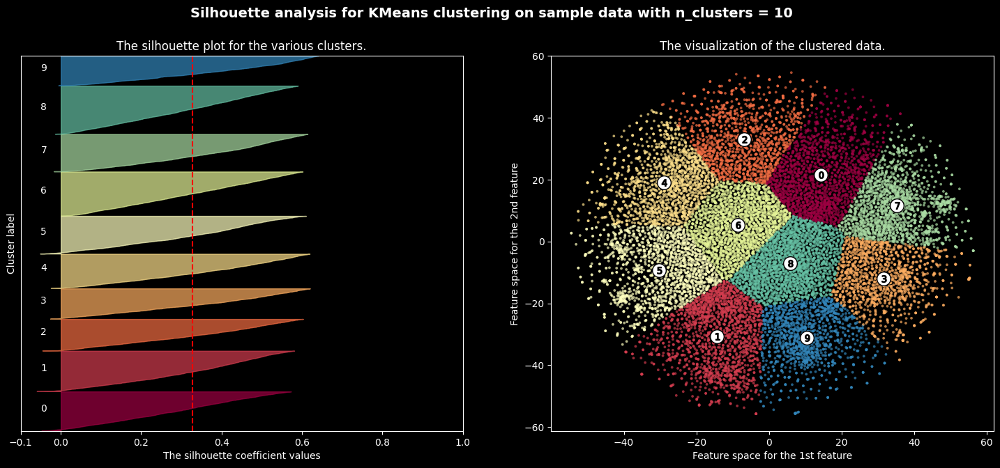

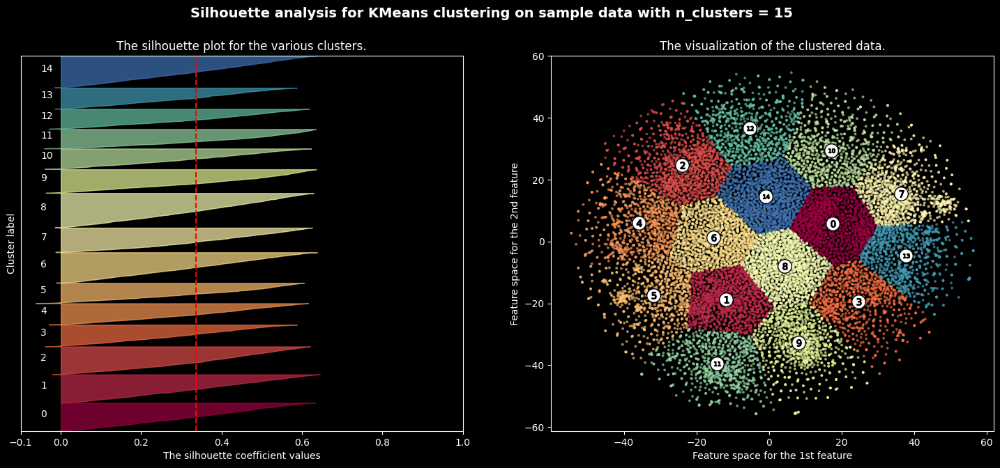

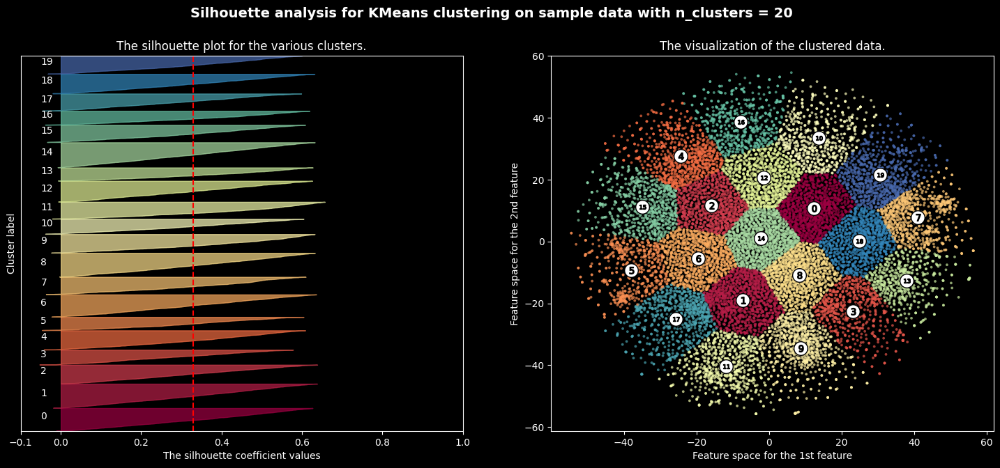

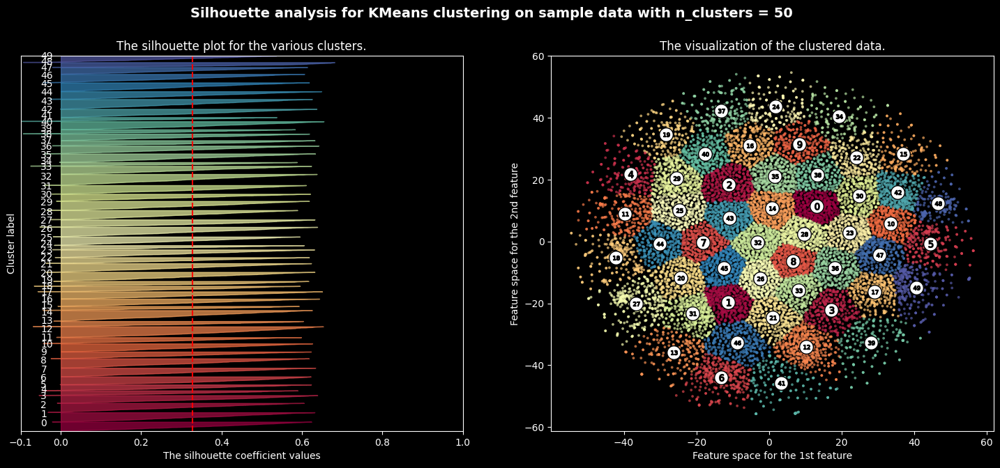

In [23]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [6, 10, 15, 20, 50]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(tsne_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator

    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=42)
    cluster_labels = clusterer.fit_predict(tsne_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(tsne_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(tsne_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        tsne_embeddings[:, 0],
        tsne_embeddings[:, 1],
        marker=".",
        s=30,
        lw=0,
        alpha=0.7,
        c=colors,
        edgecolor="k",
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

For n_clusters = 2 The average silhouette_score is : 0.31835726
For n_clusters = 3 The average silhouette_score is : 0.35471502
For n_clusters = 4 The average silhouette_score is : 0.32164922
For n_clusters = 5 The average silhouette_score is : 0.31834763
For n_clusters = 6 The average silhouette_score is : 0.32798937


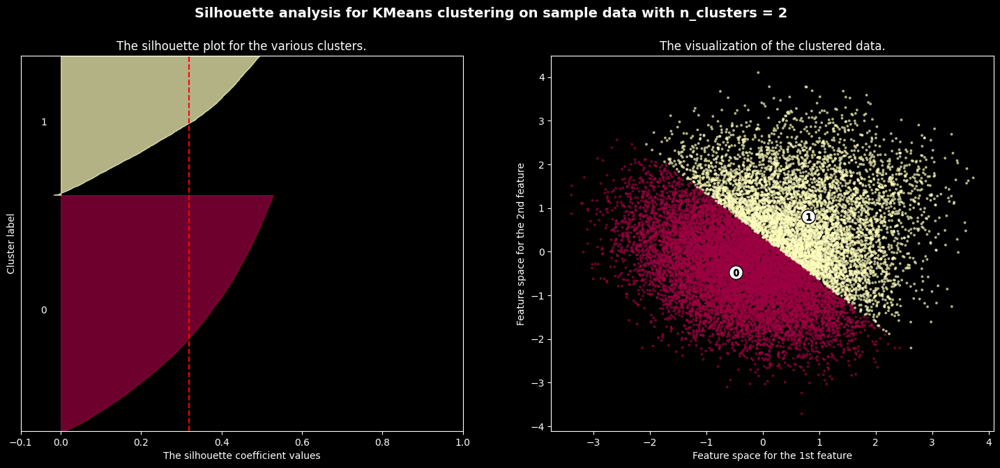

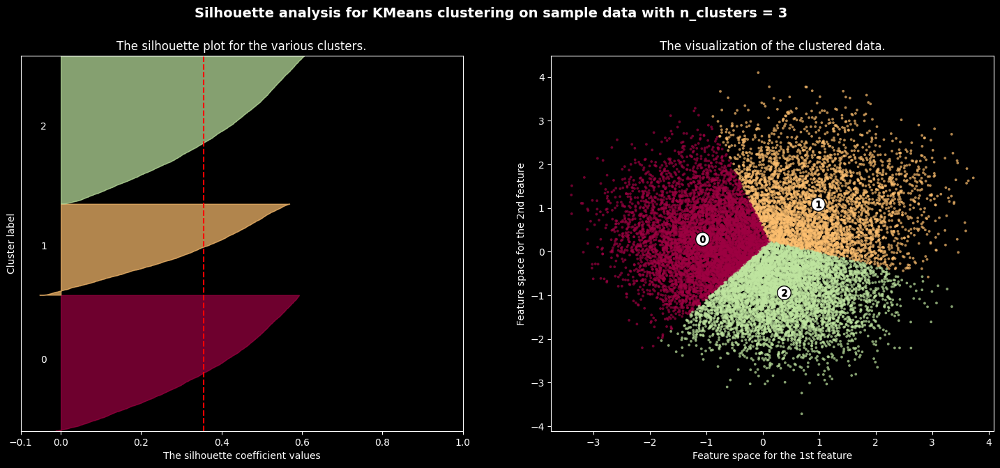

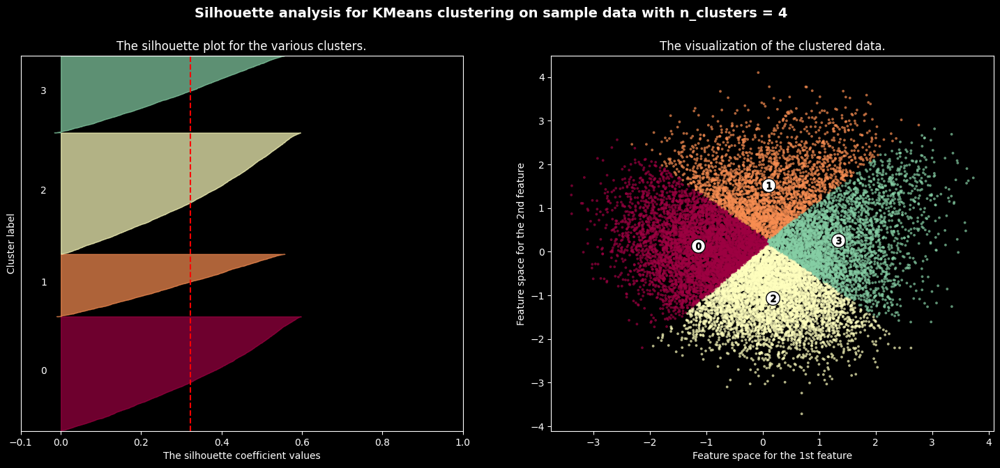

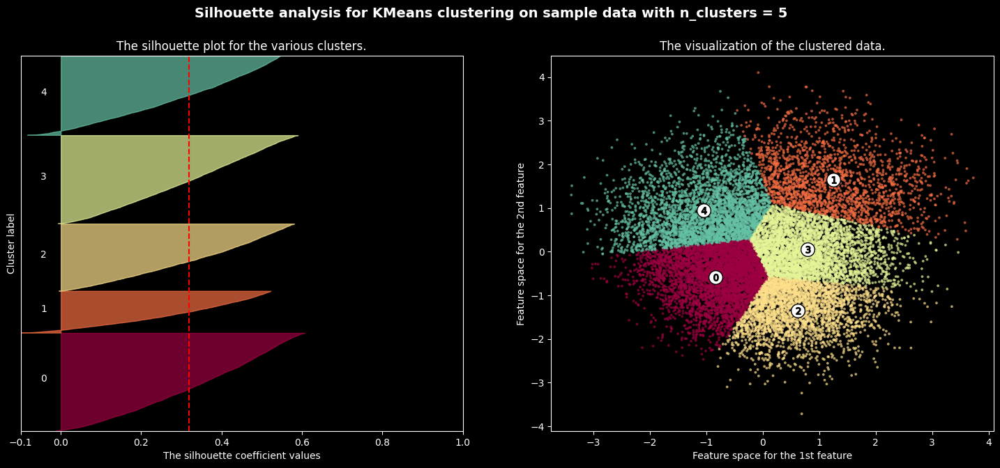

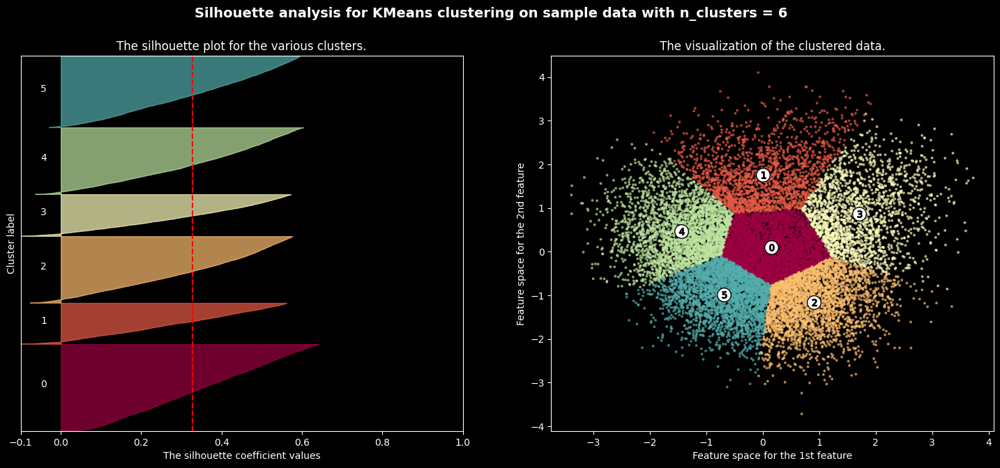

In [28]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [2,3,4,5,6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(pca_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=10)
    cluster_labels = clusterer.fit_predict(pca_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(pca_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(pca_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        pca_embeddings[:, 0], pca_embeddings[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

For n_clusters = 6 The average silhouette_score is : 0.32798937
For n_clusters = 10 The average silhouette_score is : 0.32461056
For n_clusters = 20 The average silhouette_score is : 0.3156462
For n_clusters = 50 The average silhouette_score is : 0.31828392
For n_clusters = 100 The average silhouette_score is : 0.32187092


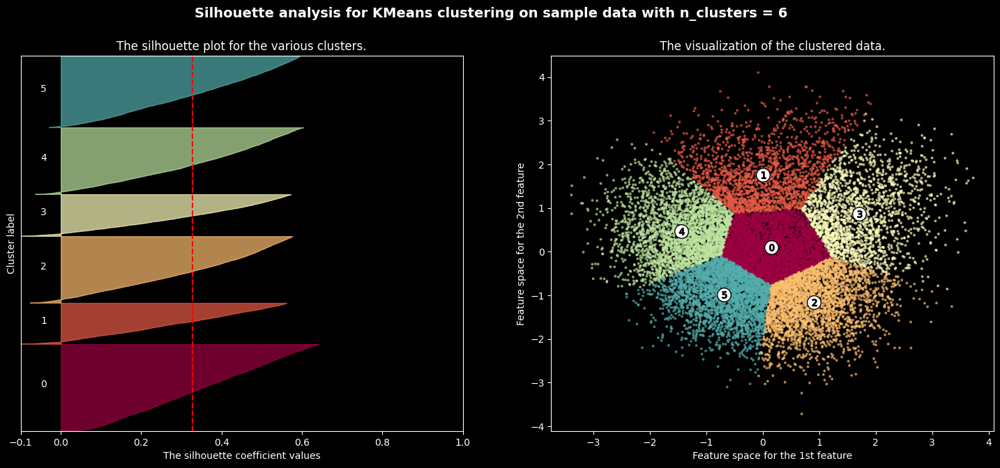

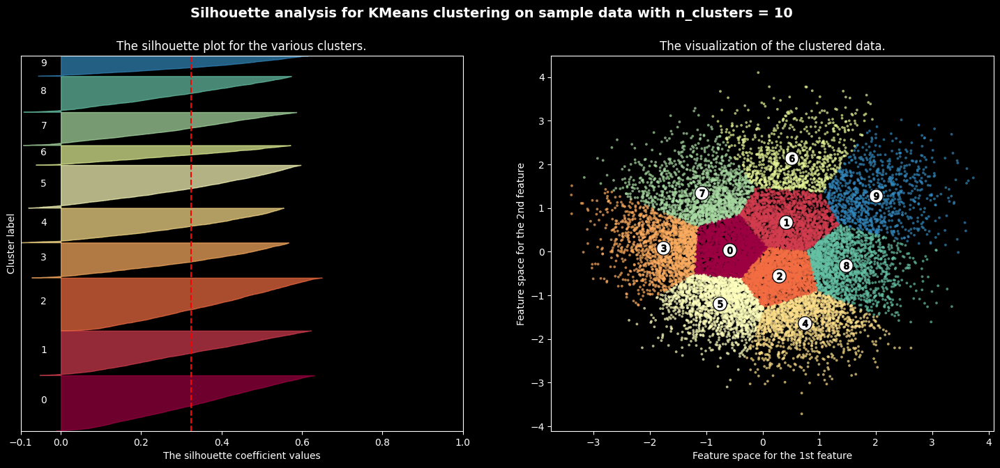

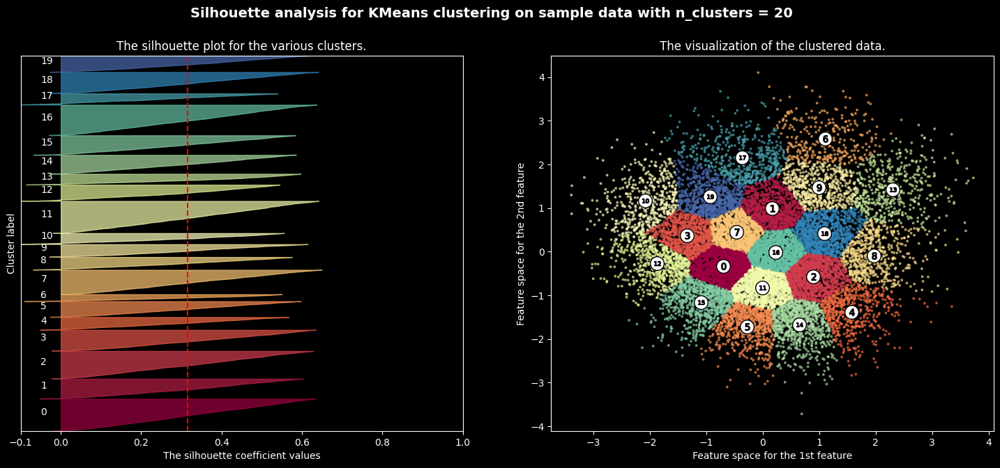

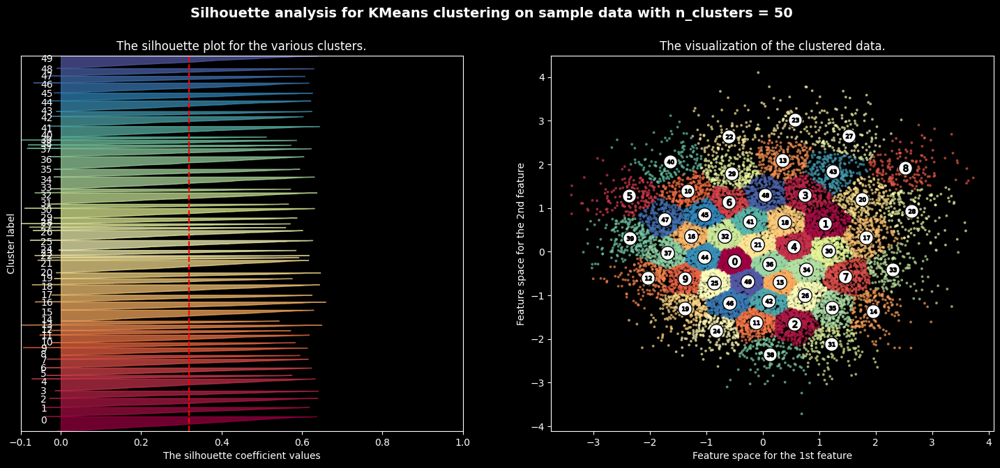

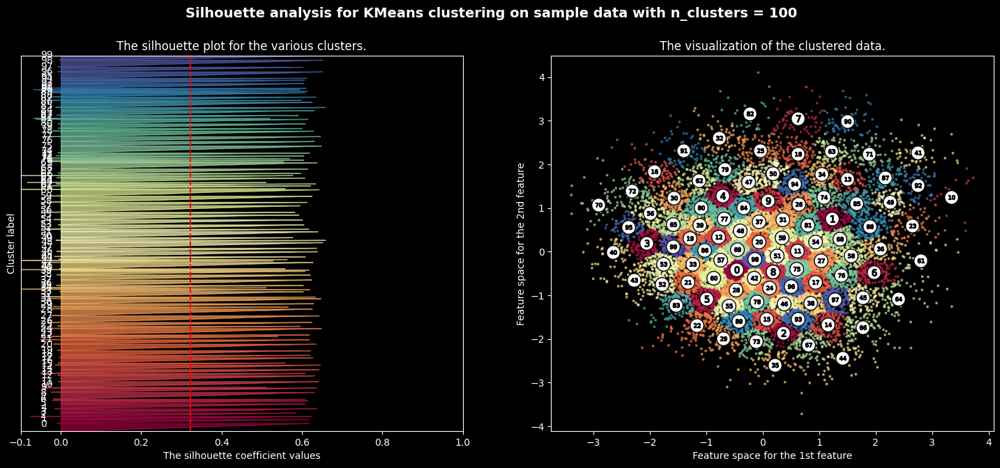

In [27]:
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.

range_n_clusters = [6, 10,20,50,100]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(pca_embeddings) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, n_init="auto", random_state=10)
    cluster_labels = clusterer.fit_predict(pca_embeddings)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(pca_embeddings, cluster_labels)
    print(
        "For n_clusters =",
        n_clusters,
        "The average silhouette_score is :",
        silhouette_avg,
    )

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(pca_embeddings, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.Spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.Spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(
        pca_embeddings[:, 0], pca_embeddings[:, 1], marker=".", s=30, lw=0, alpha=0.7, c=colors, edgecolor="k"
    )

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(
        centers[:, 0],
        centers[:, 1],
        marker="o",
        c="white",
        alpha=1,
        s=200,
        edgecolor="k",
    )

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker="$%d$" % i, alpha=1, s=50, edgecolor="k")

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )

plt.show()

In [1]:
tsne_df

NameError: name 'tsne_df' is not defined